In [4]:
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm

import os


save_root = "../../data/plot/insitu_temporal"
os.makedirs(save_root, exist_ok=True)

for l in range(1, 6):
    for s in tqdm(["spatial", "temporal"]):
        df_gldas = pd.read_csv(f"../../baseline/test_results/GLDASSM_split_method_{s}_layer_layer{l}_iid_adversial_validation/test_results.csv")
        df_automl = pd.read_csv(f"../../test_results/AutoML_split_method_{s}_layer_layer{l}_iid_adversial_validation_time_budget_600/test_results.csv")
        df_era5 = pd.read_csv(f"../../baseline/test_results/ERA5SM_split_method_{s}_layer_layer{l}_iid_adversial_validation/test_results.csv")
        df_rf = pd.read_csv(f"../../baseline/test_results/RF_split_method_{s}_layer_layer{l}_iid_adversial_validation_time_budget_600/test_results.csv")

        df_gldas.rename(columns={"pred": "GLDAS"}, inplace=True)
        df_automl.rename(columns={"pred": "AutoML"}, inplace=True)
        df_era5.rename(columns={"pred": "ERA5"}, inplace=True)
        df_rf.rename(columns={"pred": "RF"}, inplace=True)

        df = df_gldas.copy()
        df = pd.concat([df, df_automl[["AutoML"]]], axis=1)
        df = pd.concat([df, df_era5[["ERA5"]]], axis=1)
        df = pd.concat([df, df_rf[["RF"]]], axis=1)

        df["date_time"] = pd.to_datetime(df["date_time"])

        if l != 1:
            df_smci = pd.read_csv(f"../../baseline/test_results/SMCI_split_method_{s}_layer_layer{l}_iid_adversial_validation/test_results.csv")
            df_smci["date_time"] = pd.to_datetime(df_smci["date_time"])
            df_smci.rename(columns={"pred": "SMCI"}, inplace=True)
            df_smci.drop("true", axis=1, inplace=True)

            df = pd.merge(df, df_smci, on=["station_idx", "date_time"])

            assert len(df) == len(df_smci)

        df.to_csv(os.path.join(save_root, f"{s}_layer{l}.csv"), index=False)


100%|██████████| 2/2 [00:01<00:00,  1.27it/s]


100%|██████████| 2/2 [00:04<00:00,  2.42s/it]


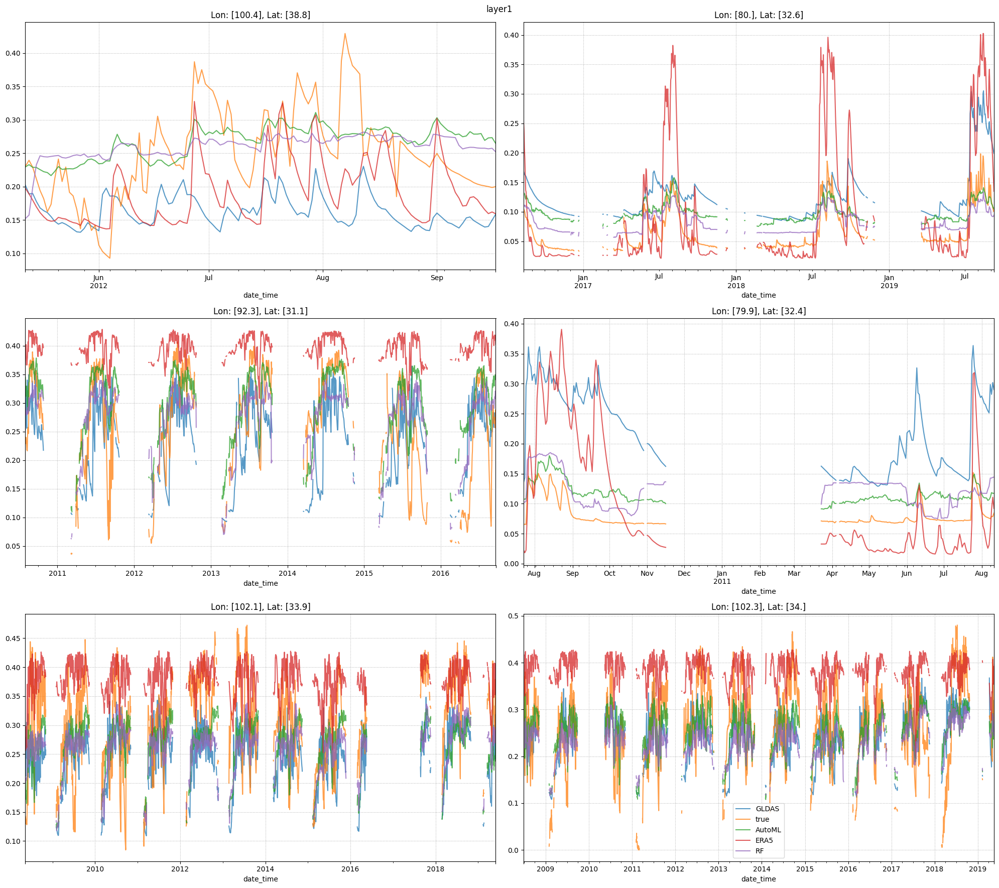

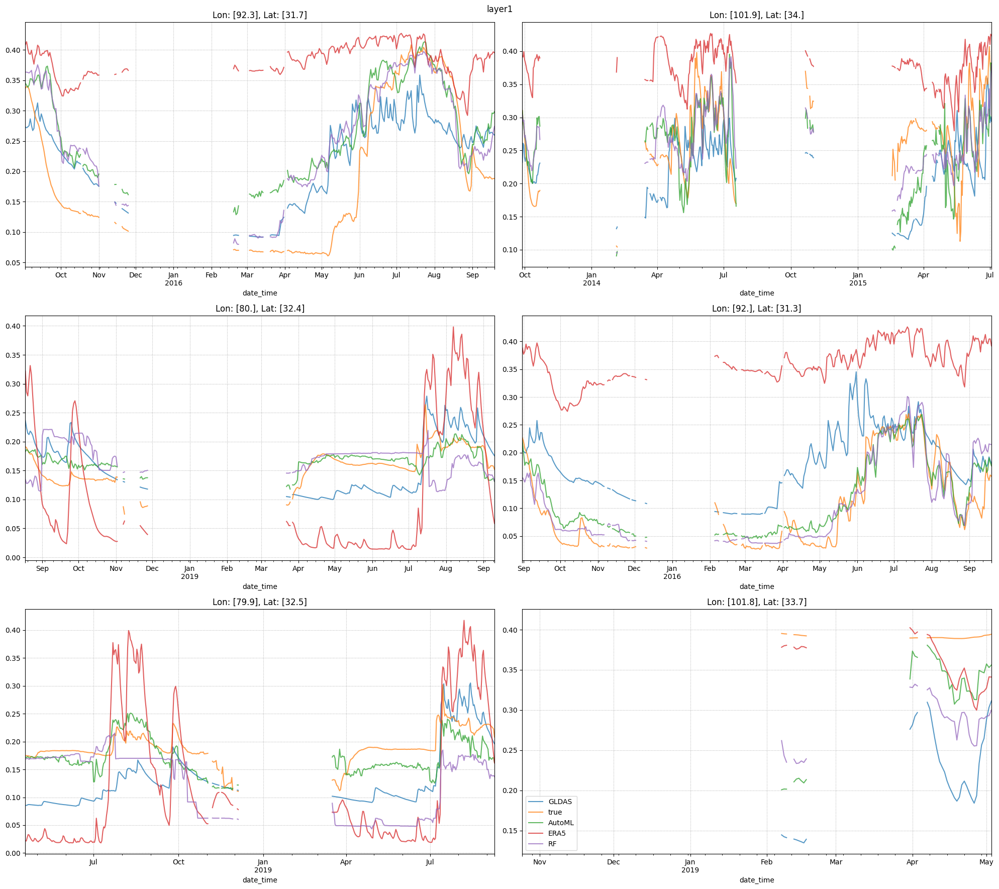

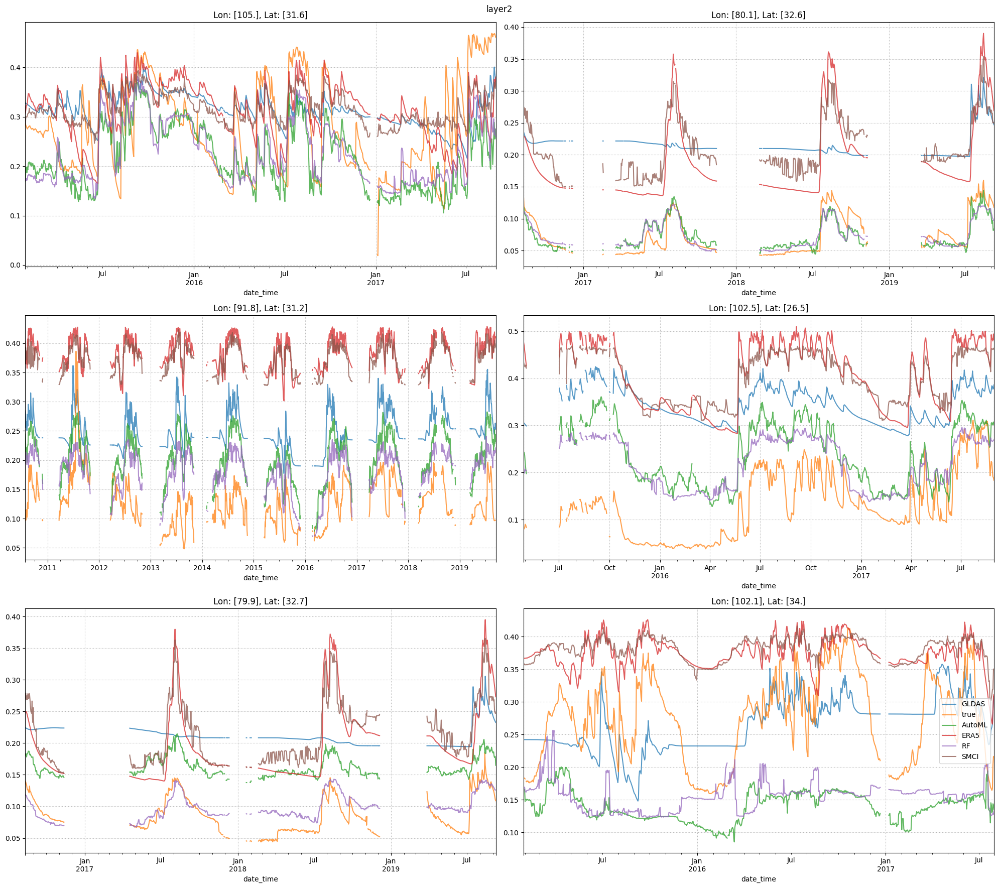

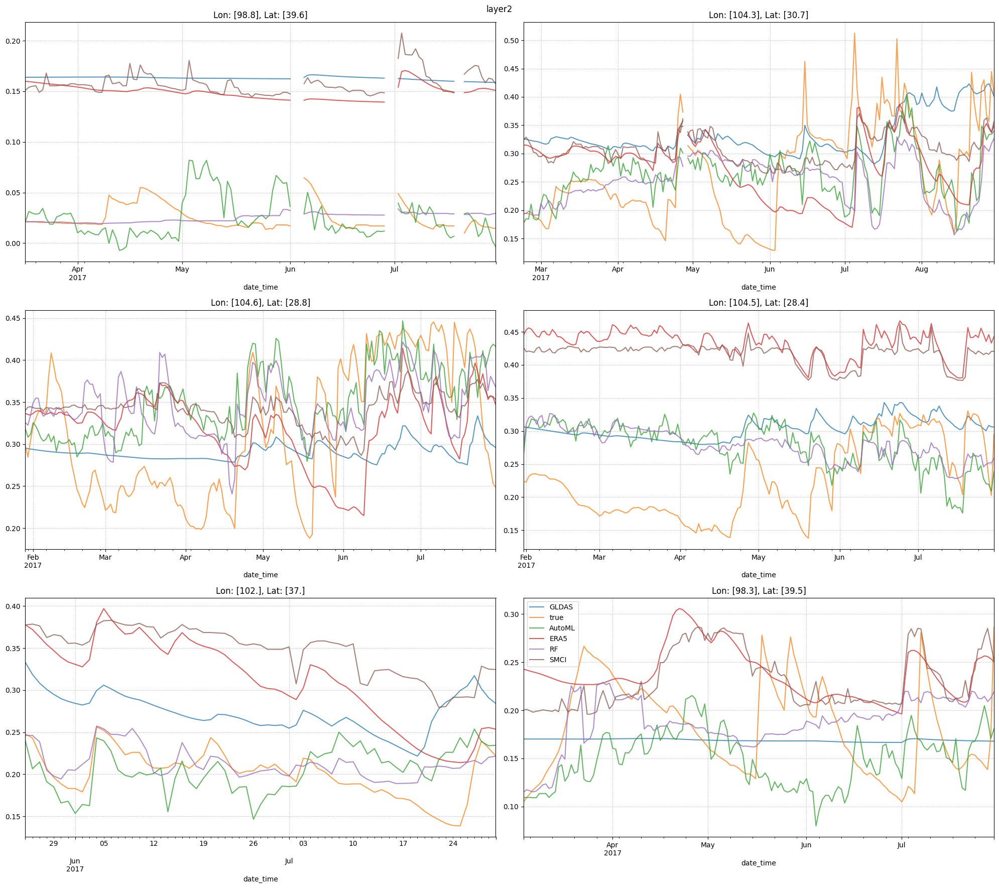

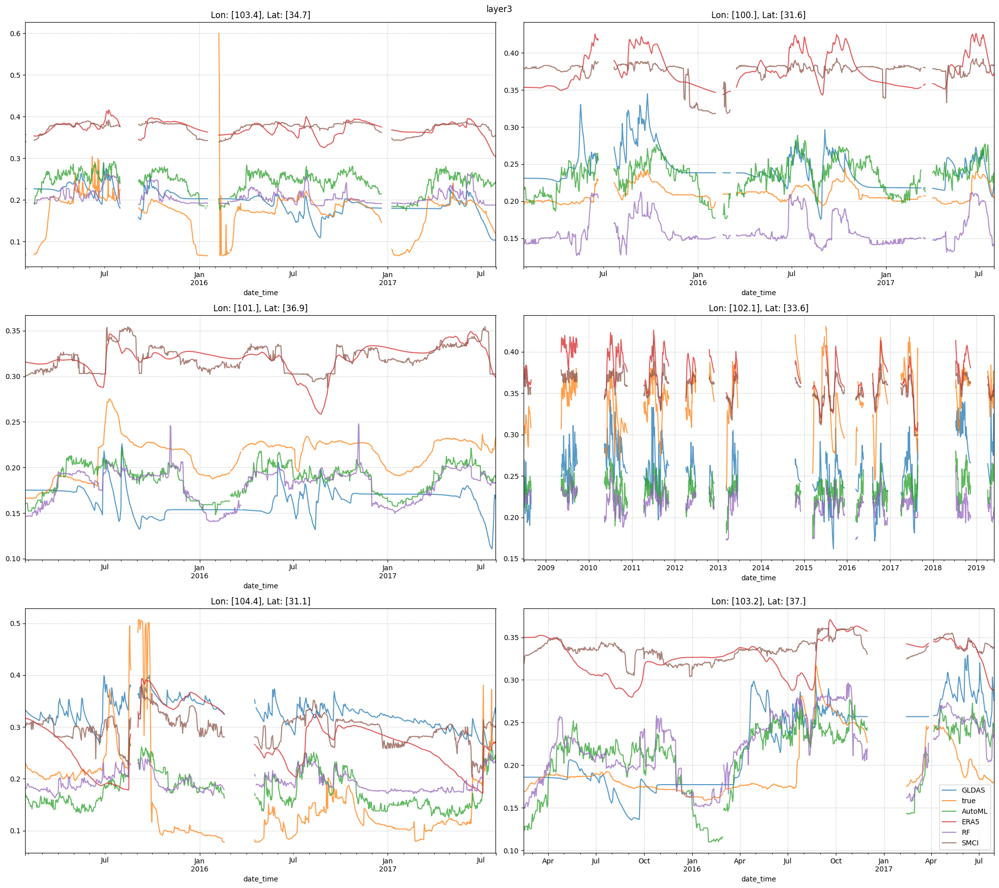

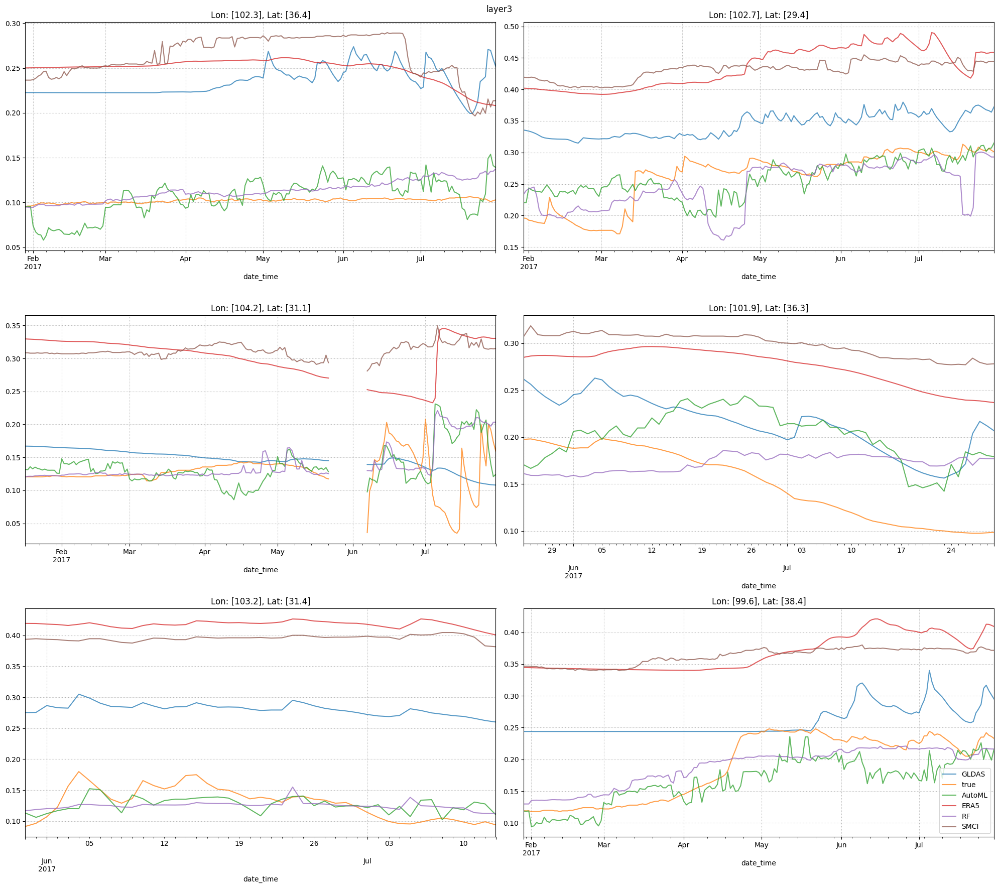

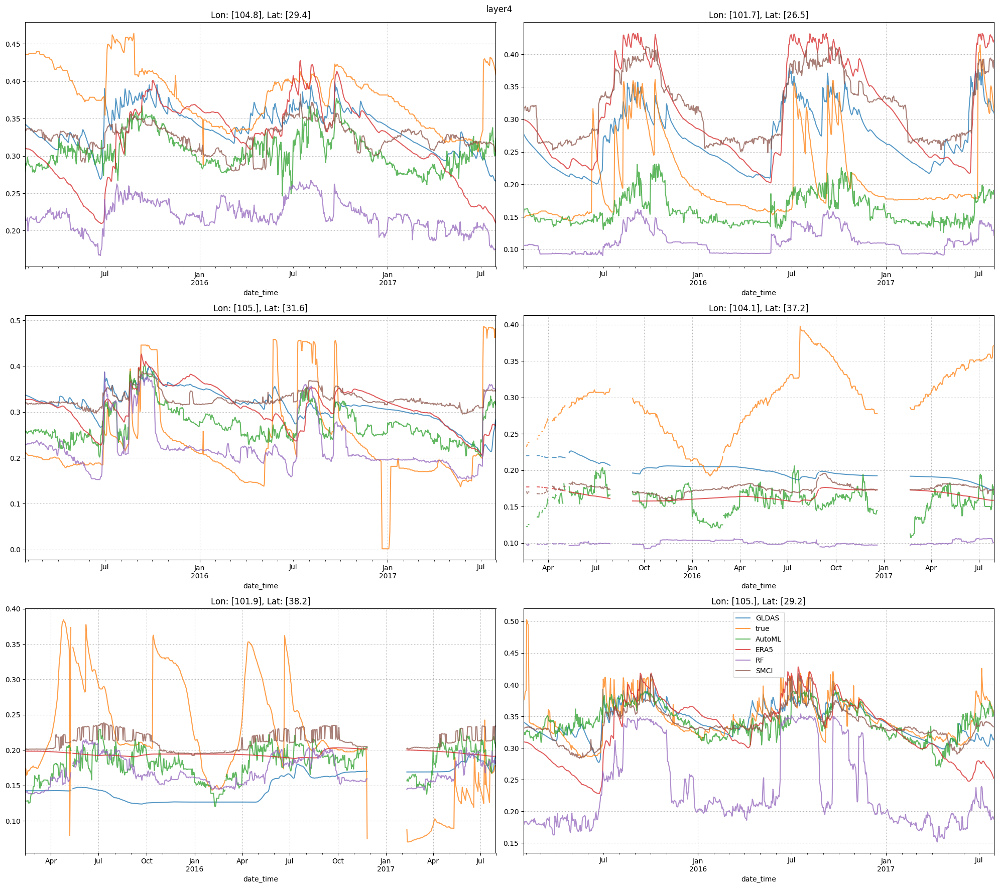

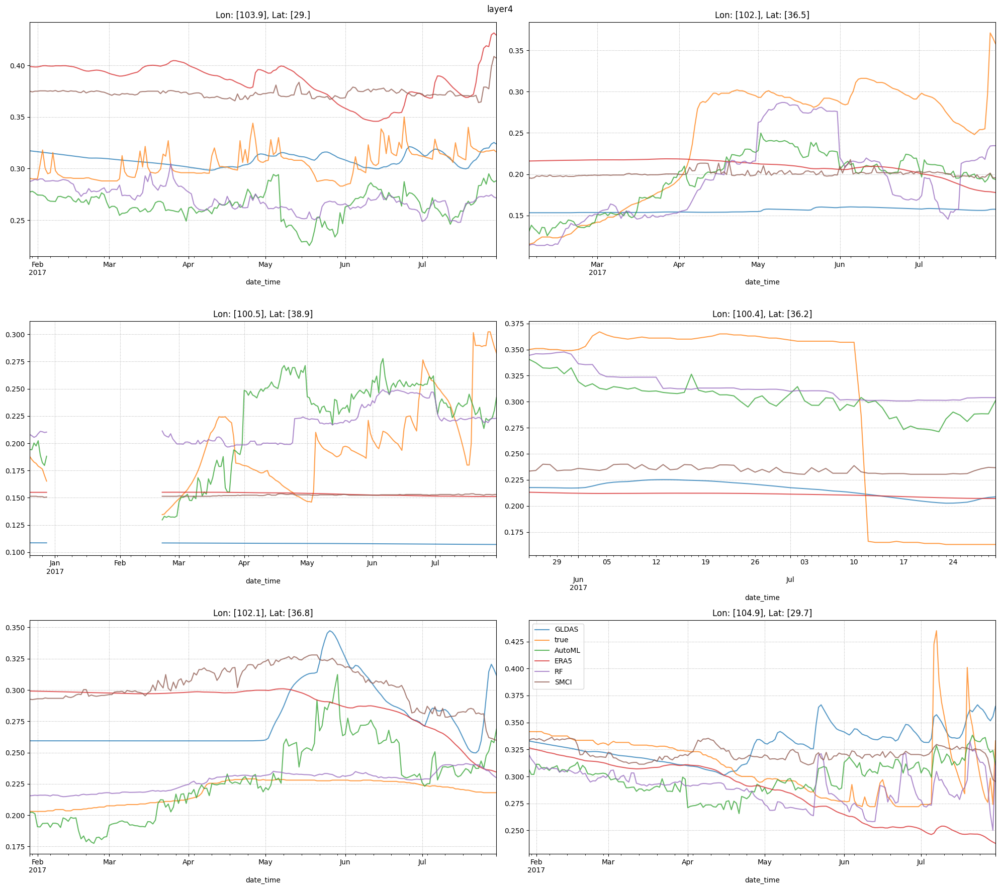

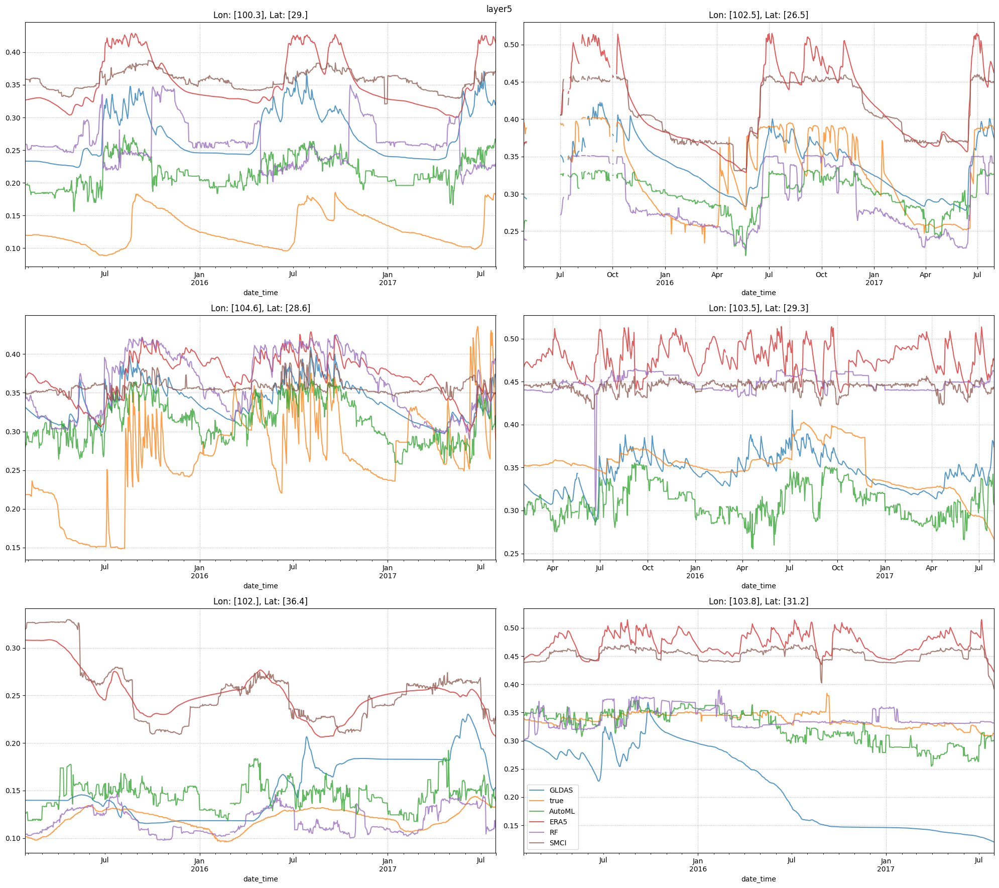

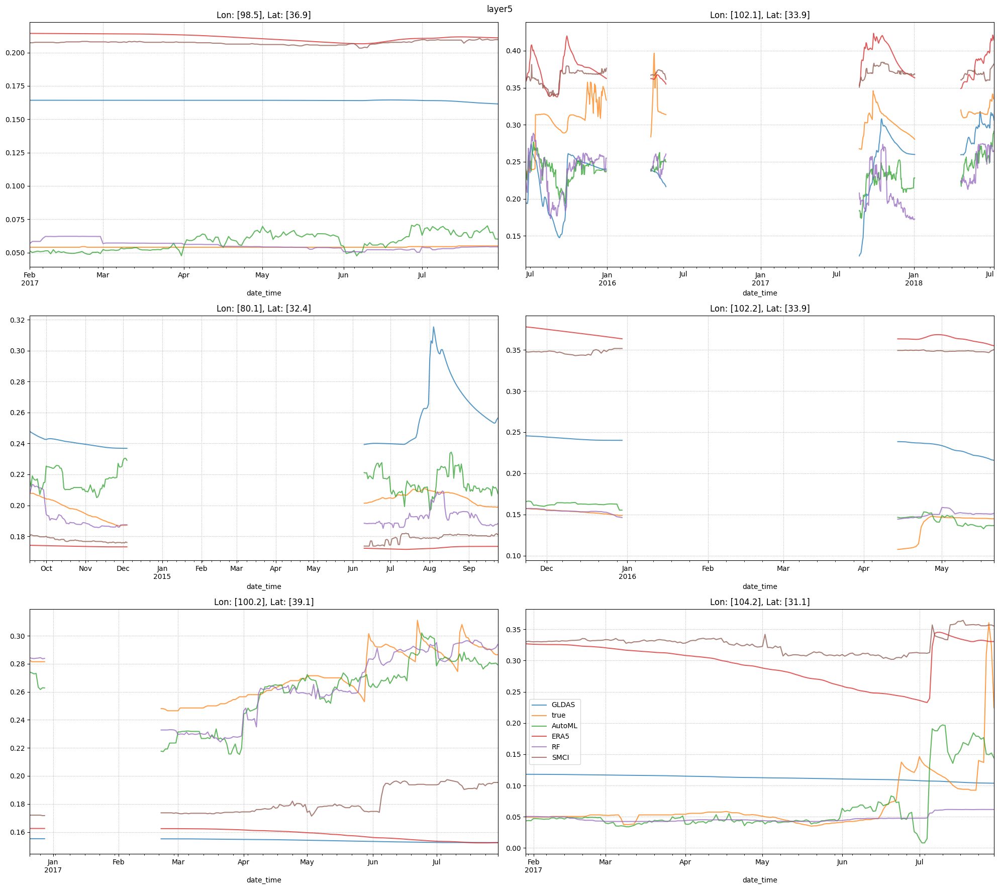

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm

import os

save_root = "../../data/plot/insitu_temporal_print"
os.makedirs(save_root, exist_ok=True)

for l in range(1, 6):
    for s in tqdm(["spatial", "temporal"]):
        df_index = pd.read_csv(f"../../data/plot/train_test_split/{s}_layer{l}.csv")
        df_index = df_index[df_index["status"] == "test"]

        # if l != 1:
        #     df_count = pd.read_csv(f"../../data/plot/insitu_metrics/smci_{s}_layer{l}.csv")
        # else:
        #     df_count = pd.read_csv(f"../../data/plot/insitu_metrics/era5_{s}_layer{l}.csv")

        df = pd.read_csv(f"../../data/plot/insitu_temporal/{s}_layer{l}.csv")

        df_index = df_index.sample(n=6, random_state=2023)

        station_idx = df_index["station_idx"].values

        df["date_time"] = pd.to_datetime(df["date_time"])

        fig, axes = plt.subplots(3, 2, figsize=(2 * 10, 3 * 6))

        axes = axes.ravel()

        for i ,(item, ax) in enumerate(zip(station_idx, axes)):
            df_it = df[df["station_idx"] == item].copy()
            df_it.drop("station_idx", axis=1, inplace=True)
            df_it.set_index("date_time", inplace=True)
            df_it.dropna(axis=0, how="any", inplace=True)
            df_it = df_it.resample("1D").asfreq()
            df_it.plot(ax=ax, title=f"Lon: {df_index[df_index['station_idx'] == item]['lon'].values}, Lat: {df_index[df_index['station_idx'] == item]['lat'].values}", 
                        alpha=0.75)

            if i != 5:
                ax.get_legend().remove()

            ax.grid(linestyle="dotted")
        
        fig.suptitle(f"layer{l}")
        plt.tight_layout()
        
        plt.savefig(os.path.join(save_root, f"{s}_layer{l}.pdf"))

In [136]:
df_automl = pd.read_csv("../../data/plot/insitu_metrics/automl_temporal_layer1.csv")
df_rf = pd.read_csv("../../data/plot/insitu_metrics/rf_temporal_layer1.csv")

df = df_automl.copy()
df["automl_rmse"] = df["rmse"]
df["rf_rmse"] = df_rf["rmse"]

assert (df_automl["station_idx"] == df_rf["station_idx"]).all()

df["rmse"] = df_rf["rmse"] - df_automl["rmse"]

# df.sort_values("rmse", ascending=False, inplace=True)
df.sort_values("automl_rmse", ascending=True, inplace=True)

df.head(50)

,station_idx,rmse,r,ubrmse,count,automl_rmse,rf_rmse
14,81,-0.000343,0.671893,0.003974,63.0,0.008939,0.008597
37,104,-0.000197,0.662972,0.007517,87.0,0.010917,0.010721
28,95,-0.000980,0.911012,0.012550,163.0,0.013714,0.012734
32,99,0.001616,0.849711,0.014450,423.0,0.014525,0.016141
63,130,-0.000998,0.712150,0.016433,204.0,0.016880,0.015882
4,71,0.005538,0.953423,0.013085,194.0,0.016909,0.022447
5,72,-0.004117,0.735480,0.012977,28.0,0.017104,0.012987
36,103,0.002675,0.927574,0.017288,163.0,0.017985,0.020659
2,69,0.002545,0.784618,0.016711,28.0,0.019041,0.021586
59,126,0.001154,0.742898,0.019147,319.0,0.019150,0.020304


<Axes: xlabel='date_time'>

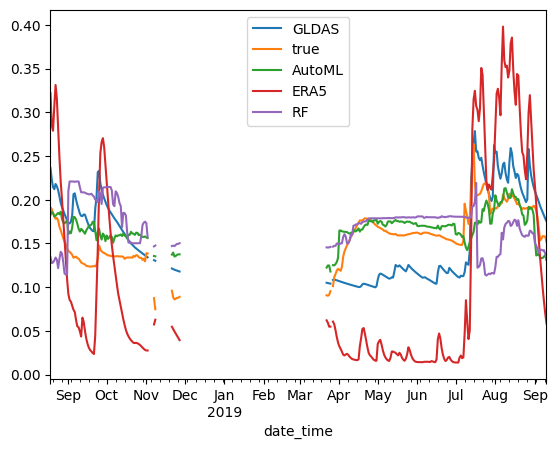

In [146]:
df = pd.read_csv("../../data/plot/insitu_temporal/temporal_layer1.csv")
df["date_time"] = pd.to_datetime(df["date_time"])
df = df[df["station_idx"] == 76]

df.set_index("date_time", inplace=True)
df = df.resample("1D").asfreq()


df.drop("station_idx", axis=1).plot()


# layer1 
## spatial
62, 66, 55, 64, 58, 53
## temporal
99, 71, 103, 126, 118, 76

# layer2
## spatial  
263, 251, 247, 236, 244, 264  
## temporal
298, 374, 279, 275, 526, 329

# layer3
## spatial
218, 255, 239, 221, 242, 217  
## temporal
418, 417, 473, 293, 329, 265

# layer4 
## spatial  
202, 186, 188, 197, 182, 198
## temporal
298, 342, 208, 264, 242, 209

# layer5
## spatial
177, 197, 183, 208, 182, 195  
## temporal 
354, 277, 284, 407, 425, 359

100%|██████████| 2/2 [00:06<00:00,  3.39s/it]


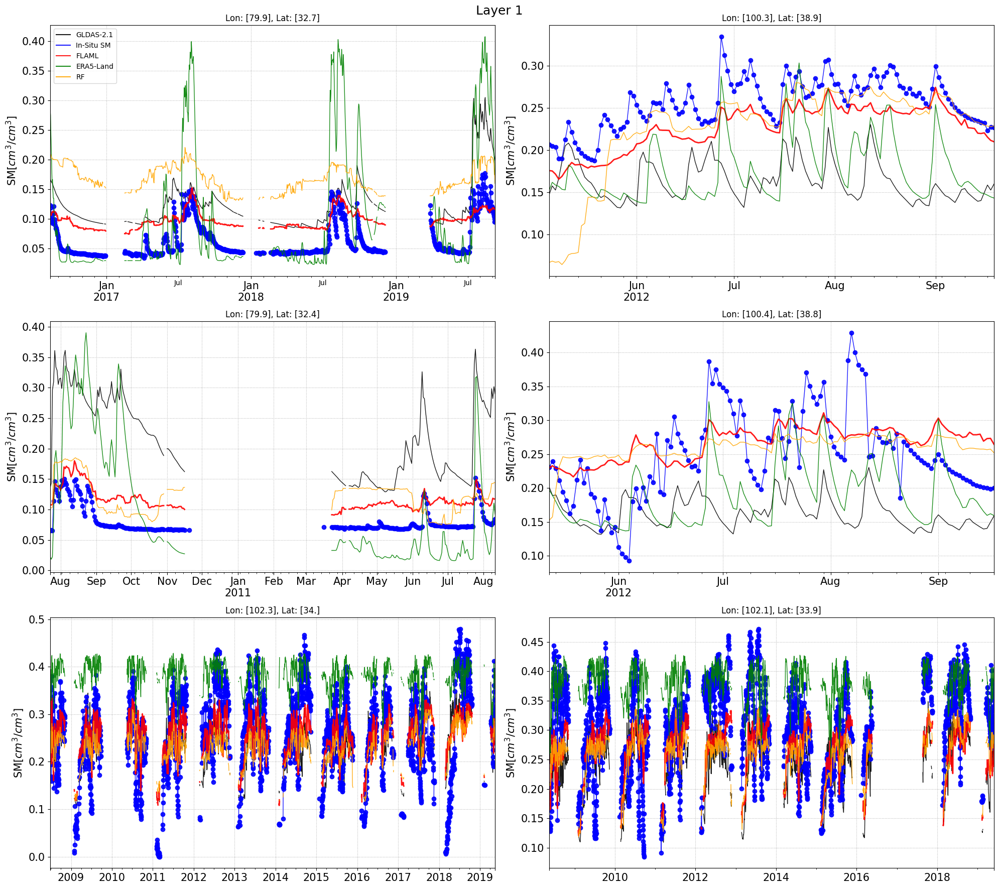

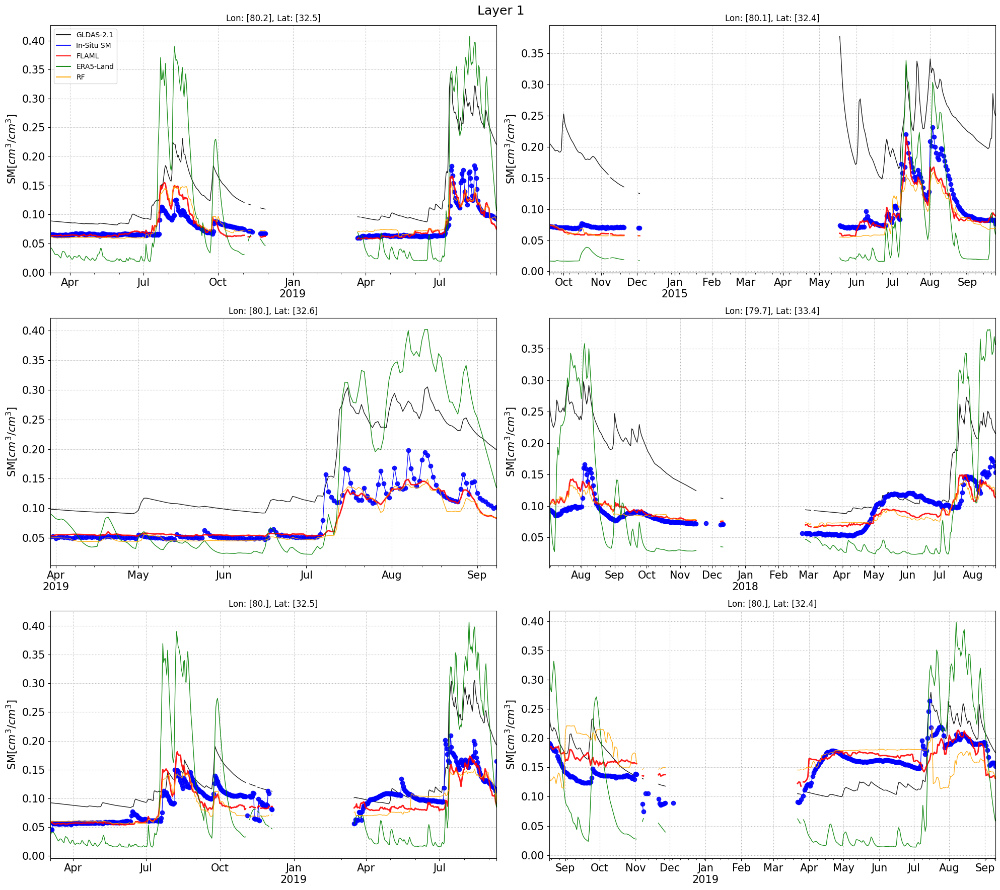

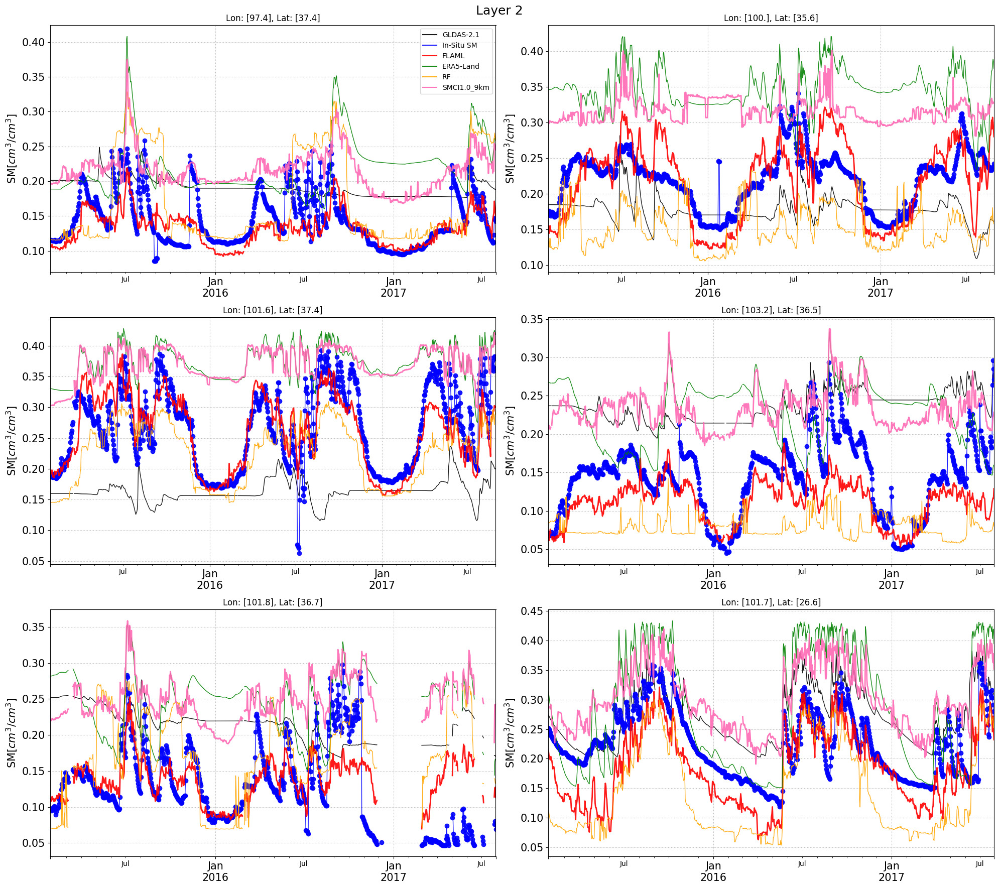

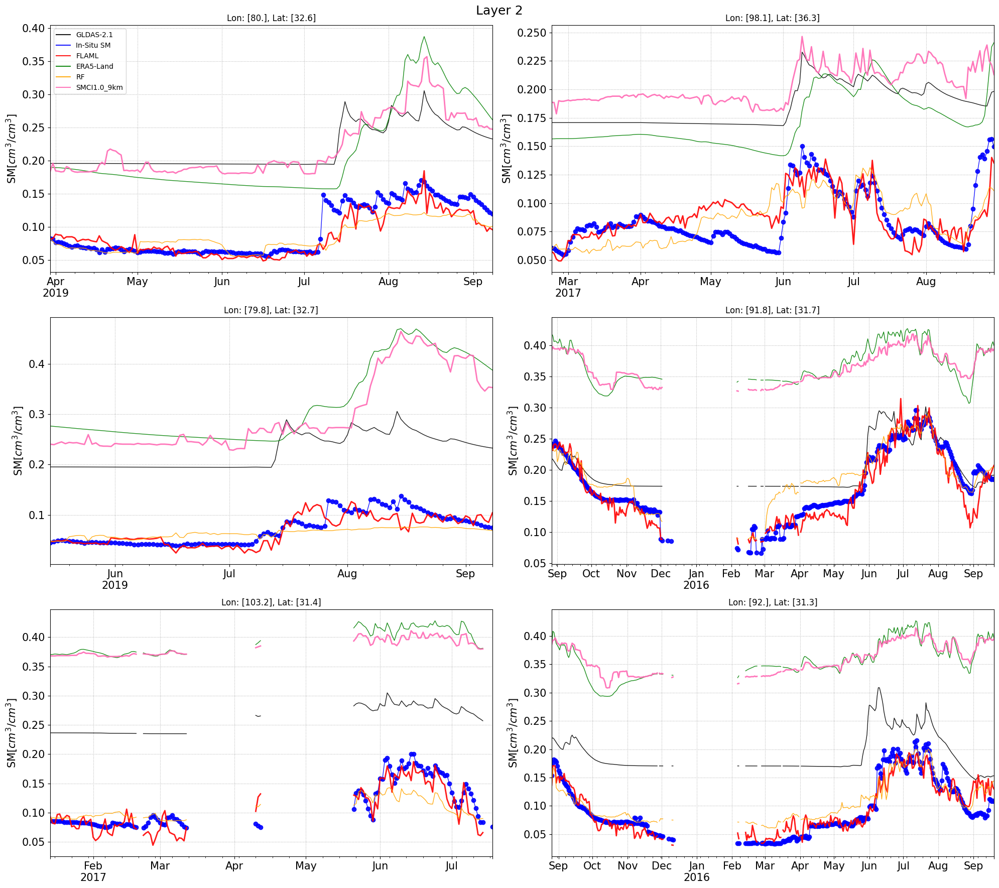

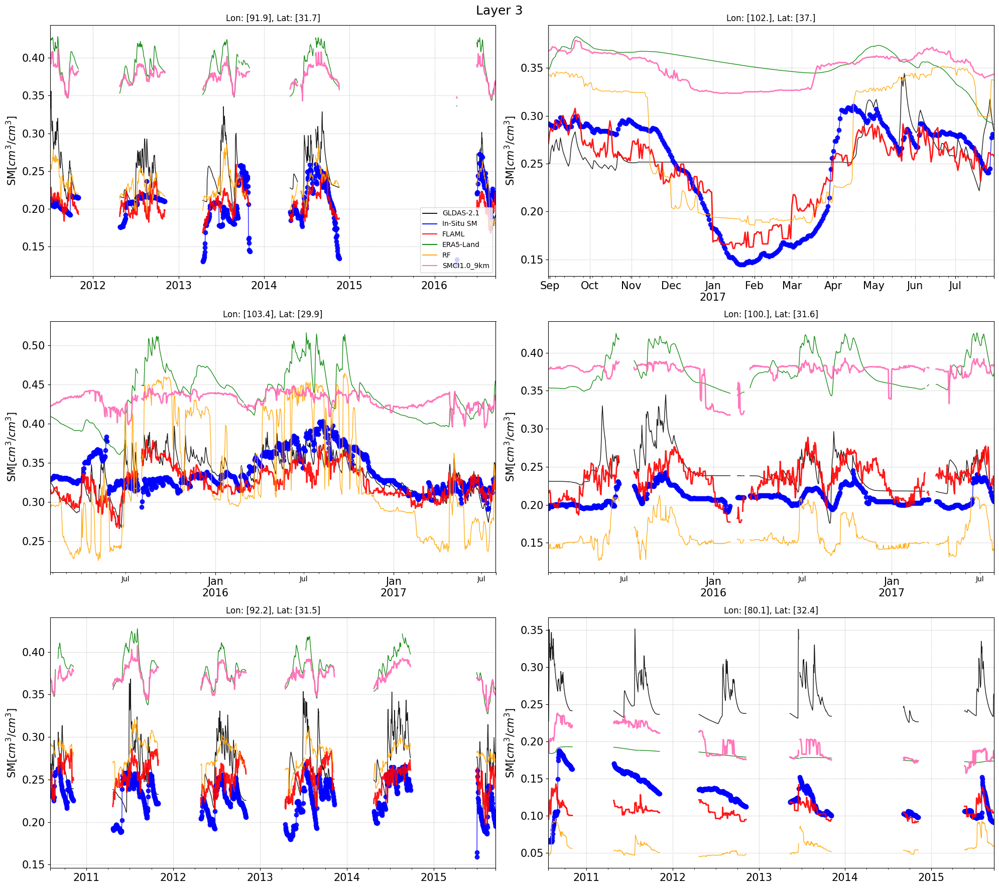

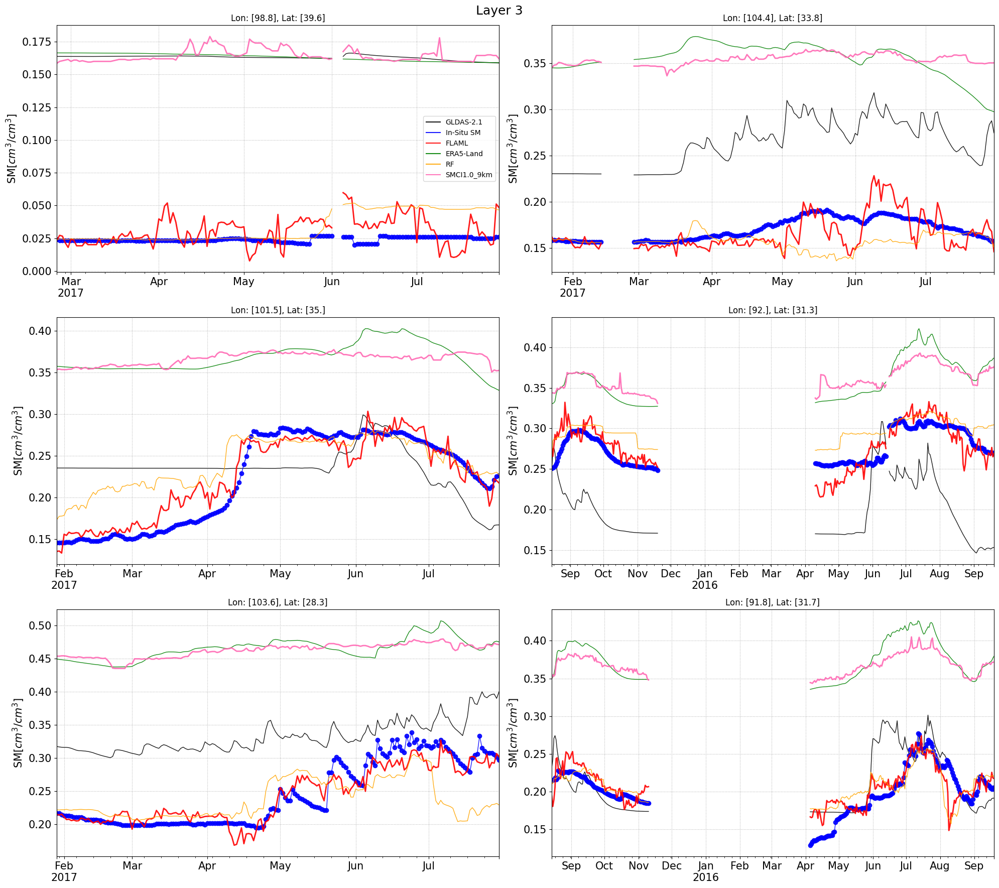

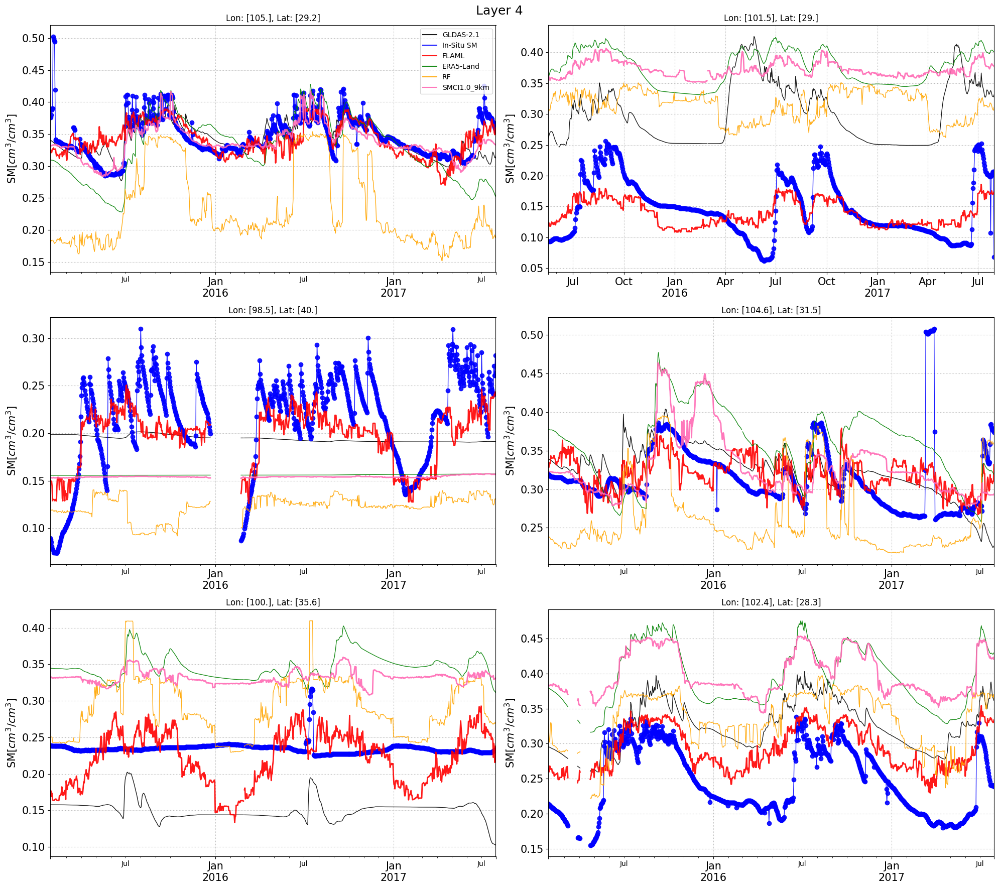

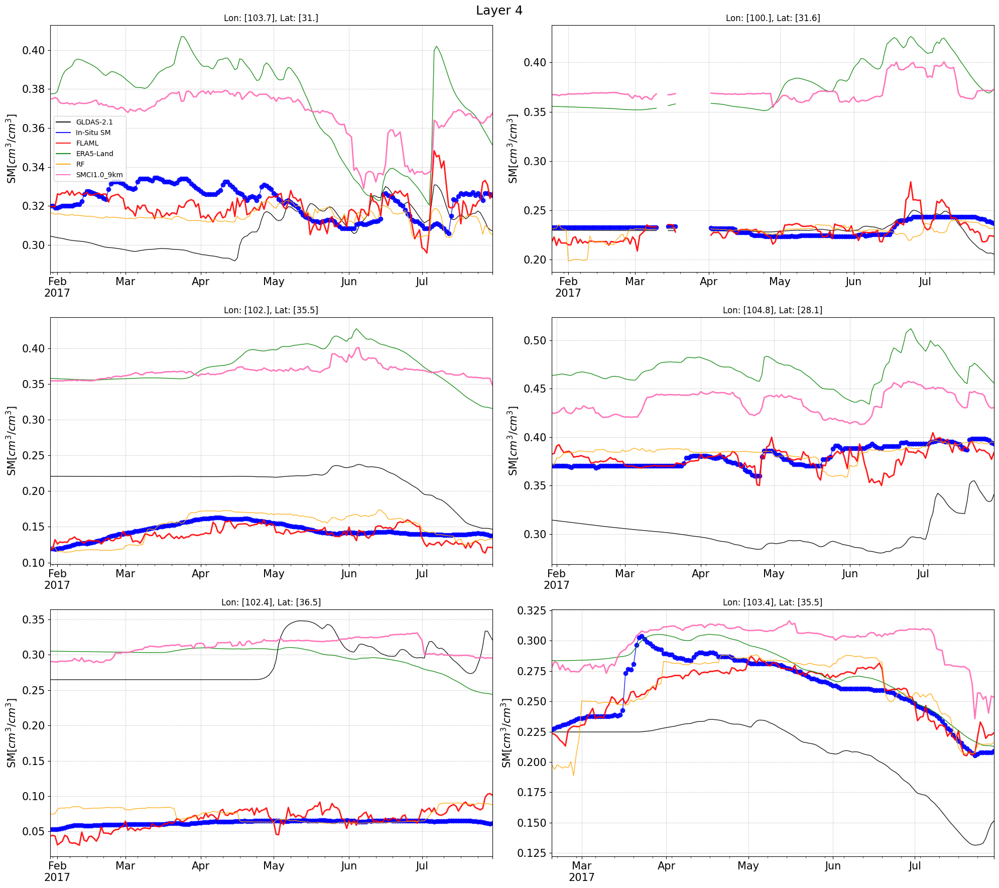

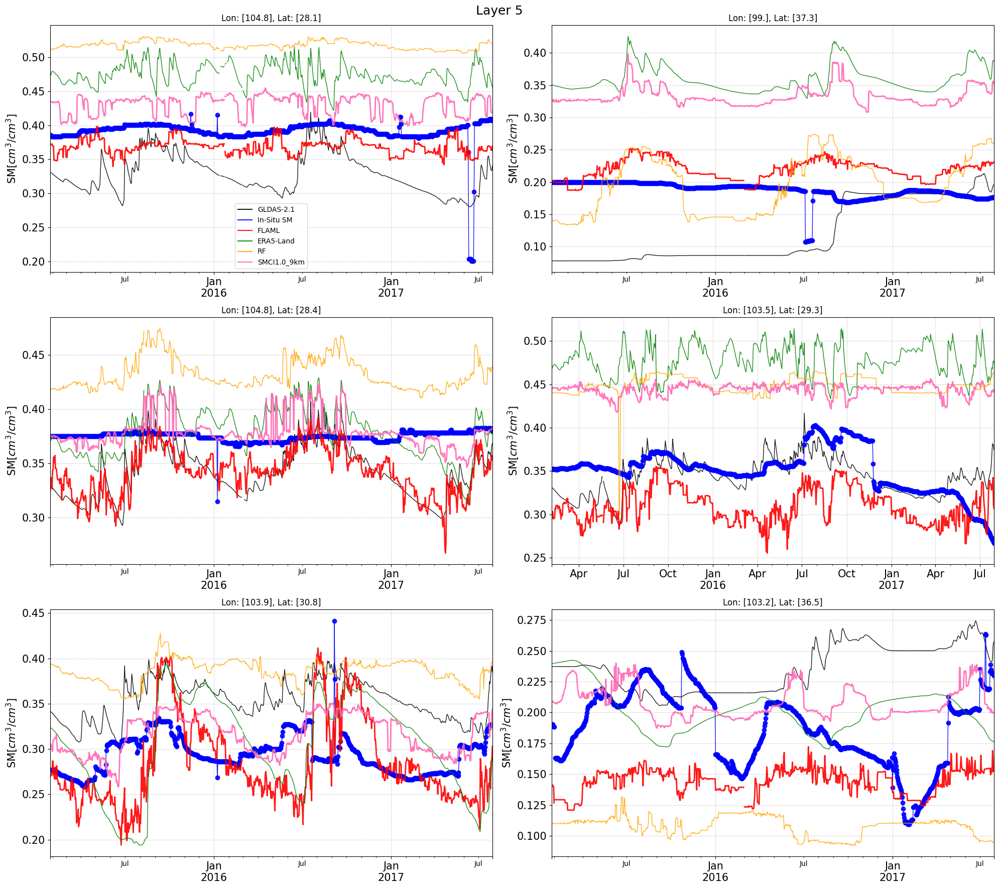

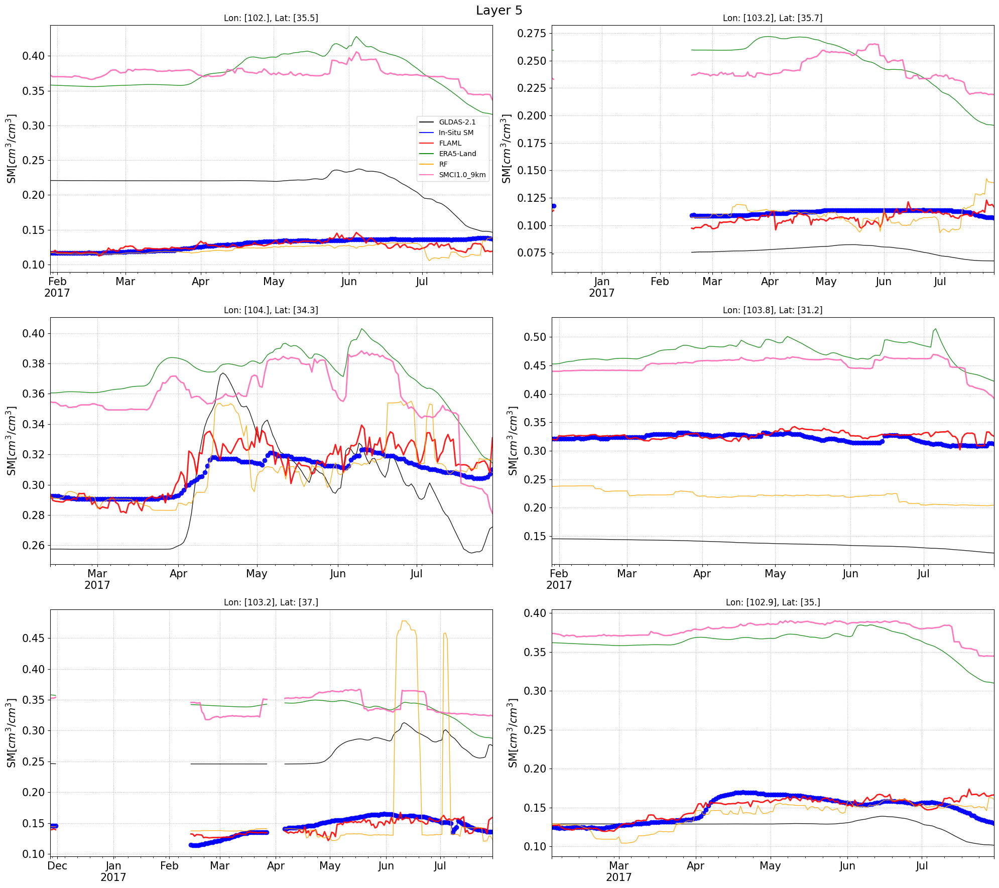

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm

import os

# pb
save_root = "../../data/plot/insitu_temporal_print_pb"
os.makedirs(save_root, exist_ok=True)

# pb
pb_map = {
    "layer1": {
        "spatial": [62, 66, 55, 64, 58, 53], 
        "temporal": [99, 71, 103, 126, 118, 76]
    }, 
    "layer2": {
        "spatial": [263, 251, 247, 236, 244, 264], 
        "temporal": [298, 374, 279, 275, 526, 329]
    }, 
    "layer3": {
        "spatial": [218, 255, 239, 221, 242, 217], 
        "temporal": [418, 417, 473, 293, 329, 265]
    }, 
    "layer4": {
        "spatial": [202, 186, 188, 197, 182, 198], 
        "temporal": [298, 342, 208, 264, 242, 209]
    }, 
    "layer5": {
        "spatial": [177, 197, 183, 208, 182, 195], 
        "temporal": [354, 277, 284, 407, 425, 359]
    }
}
pb_color = {
    "In-Situ SM": "blue", 
    "FLAML": "red", 
    "SMCI1.0_9km": "hotpink", 
    "ERA5-Land": "green", 
    "GLDAS-2.1": "k", 
    "RF": "orange"
}
pb_lw = {
    "In-Situ SM": 1, 
    "FLAML": 2, 
    "SMCI1.0_9km": 2, 
    "ERA5-Land": 1, 
    "GLDAS-2.1": 1, 
    "RF": 1
}

# change fontsize
factor = 1.5

for l in range(1, 6):
    for s in tqdm(["spatial", "temporal"]):
        df_index = pd.read_csv(f"../../data/plot/train_test_split/{s}_layer{l}.csv")
        df_index = df_index[df_index["status"] == "test"]

        # if l != 1:
        #     df_count = pd.read_csv(f"../../data/plot/insitu_metrics/smci_{s}_layer{l}.csv")
        # else:
        #     df_count = pd.read_csv(f"../../data/plot/insitu_metrics/era5_{s}_layer{l}.csv")

        df = pd.read_csv(f"../../data/plot/insitu_temporal/{s}_layer{l}.csv")

        # pb
        if l ==1:
            df.rename(columns={"GLDAS": "GLDAS-2.1", "true": "In-Situ SM", "ERA5": "ERA5-Land", 
                           "AutoML": "FLAML", "RF": "RF"}, inplace=True)
        else:
            df.rename(columns={"GLDAS": "GLDAS-2.1", "true": "In-Situ SM", "ERA5": "ERA5-Land", 
                           "AutoML": "FLAML", "RF": "RF", "SMCI": "SMCI1.0_9km"}, inplace=True)

        # df_index = df_index.sample(n=6, random_state=2023)

        # station_idx = df_index["station_idx"].values

        # pb
        station_idx = pb_map[f"layer{l}"][s]

        df["date_time"] = pd.to_datetime(df["date_time"])

        fig, axes = plt.subplots(3, 2, figsize=(2 * 10, 3 * 6))

        axes = axes.ravel()

        for i ,(item, ax) in enumerate(zip(station_idx, axes)):
            # change fontsize
            for ax_item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + 
                ax.get_xticklabels() + ax.get_yticklabels()):
                ax_item.set_fontsize(ax_item.get_fontsize() * factor)
            df_it = df[df["station_idx"] == item].copy()
            df_it.drop("station_idx", axis=1, inplace=True)
            # pb
            df_it.rename(columns={"date_time": "time"}, inplace=True)
            df_it.set_index("time", inplace=True)
            df_it.dropna(axis=0, how="any", inplace=True)
            df_it = df_it.resample("1D").asfreq()
            df_it.plot(ax=ax, title=f"Lon: {df_index[df_index['station_idx'] == item]['lon'].values}, Lat: {df_index[df_index['station_idx'] == item]['lat'].values}", 
                        alpha=0.9, color=[pb_color[x] for x in df_it.columns.to_list()])
            
            columns = df_it.columns.to_list()
            for col_i, line in enumerate(ax.lines):
                plt.setp(line, linewidth=pb_lw[columns[col_i]])
                if columns[col_i] == "In-Situ SM":
                    plt.setp(line, marker="o")

            ax.set_ylabel("SM[$cm^3/cm^3$]")

            # if i != 5:
            if i != 0:
                ax.get_legend().remove()

            ax.grid(linestyle="dotted")
            ax.set_xlabel("")
        
        fig.suptitle(f"Layer {l}", fontsize=12 * factor)
        plt.tight_layout()

        plt.savefig(os.path.join(save_root, f"{s}_layer{l}.pdf"))
        